In [92]:
# import libraries

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from PIL import Image

import plotly as py
import plotly.express as px
import plotly.offline as pyo
import plotly.graph_objs as go

from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

%matplotlib inline

In [93]:
df = pd.read_csv('../data/final_hurricane_labeled.csv')

In [94]:
df.head()

,Date,text_clean,label,n_sentence,n_words,lat,long
0,2020-08-31 23:15:25+00:00,a customer service rep told me friday there is...,0,2,11,25.525284,-80.606920
1,2020-08-31 22:39:25+00:00,tomorrow at pm after hour with sabor havana ci...,0,2,19,27.686273,-80.934588
2,2020-08-31 22:31:09+00:00,hurricane laura wallop area with high mortgage...,0,2,13,27.701712,-75.255859
3,2020-08-31 20:25:29+00:00,i never wish bad on anyone but think we need a...,0,1,9,29.114762,-84.339632
4,2020-08-31 19:51:39+00:00,wth is pricemart so full their a hurricane idk...,0,2,5,28.506867,-89.678090


In [95]:
df.isnull().sum() # --> due to stemming. dropping nulls

Date           0
text_clean    25
label          0
n_sentence     0
n_words        0
lat            0
long           0
dtype: int64

In [96]:
# it could be due to non-english tweets that I did not know how to process in cleaning stage 
# will drop these rows

df.dropna(axis = 0, inplace = True)

In [97]:
df.isnull().sum()

Date          0
text_clean    0
label         0
n_sentence    0
n_words       0
lat           0
long          0
dtype: int64

In [98]:
# overwrite the final_labeled.csv file to store cleaner dataset

df.to_csv('../data/final_hurricane_labeled.csv', index = False)

In [99]:
columns = [col for col in df.columns if col != 'label']

fig = px.histogram(df, x = 'n_words', color = 'label', marginal = 'box', hover_data = columns,
                   labels = {'n_words': 'Number of Words in a Single Tweet',
                             'label': 'Disaster (1) or Non-disaster(0)'},
                   color_discrete_sequence = ['hotpink', 'slategray'])
pyo.iplot(fig)

fig.write_html(f'../images/word_count.html')

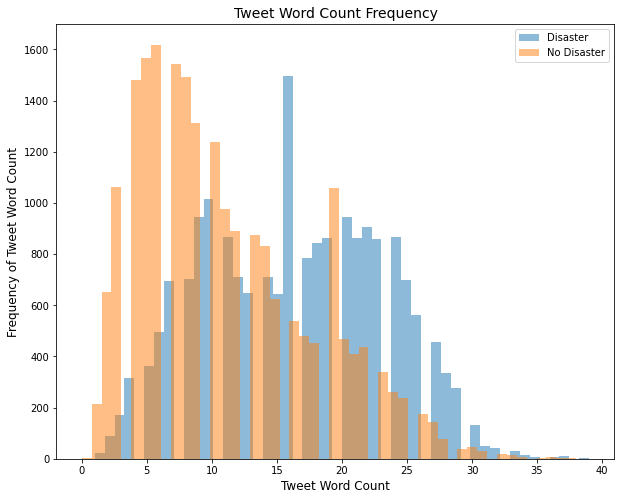

In [100]:
# distribution of word counts 

plt.figure(figsize = (10, 8))

plt.hist(df[df['label'] == 1]['n_words'], bins = 50, alpha = 0.5, label = 'Disaster')
plt.hist(df[df['label'] == 0]['n_words'], bins = 50, alpha = 0.5, label = 'No Disaster')
plt.xlabel('Tweet Word Count', size = 12)
plt.ylabel('Frequency of Tweet Word Count', size = 12)
plt.title('Tweet Word Count Frequency', size = 14)

plt.legend()
plt.savefig('../images/word_count.png');

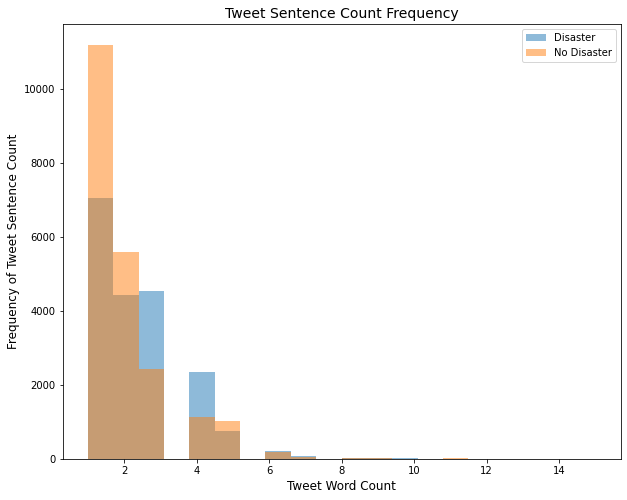

In [101]:
# distribution of sentence counts 

plt.figure(figsize = (10, 8))

plt.hist(df[df['label'] == 1]['n_sentence'], bins = 20, alpha = 0.5, label = 'Disaster')
plt.hist(df[df['label'] == 0]['n_sentence'], bins = 20, alpha = 0.5, label = 'No Disaster')
plt.xlabel('Tweet Word Count', size = 12)
plt.ylabel('Frequency of Tweet Sentence Count', size = 12)
plt.title('Tweet Sentence Count Frequency', size = 14)

plt.legend()
plt.savefig('../images/sentence_count.png');

In [102]:
# set X for vectorization

X = df['text_clean']

In [ ]:
# Count Vectorizer

In [103]:
# create custom stop words

irrelevant_words = ['aren', 'couldn', 'didn', 'doesn', 'don', 'hadn', 'hasn', 'haven', 'isn', 'let', 'll', 'mustn', 're', 'shan', 
                  'shouldn', 've', 'wasn', 'weren', 'won', 'wouldn', 'co', 'pm', 'wa', 'edt', 'amp', 'ha', 'cdt', 'one', 'state', 'hurricane', 'laura','hurricanelaura',
                   'trump', 'texas', 'louisiana', 'tx', 'houston']

# using wordcloud stopwords

stop = list(STOPWORDS) + irrelevant_words

In [104]:
# instantiate countvectorizer with stopwords

cvec = CountVectorizer(stop_words = stop)

In [105]:
# transform and fit on X_train, and transform X_test

X_cv = cvec.fit_transform(X)

print(X_cv.shape)

(41076, 28229)


In [106]:
# turn X_train to a dataframe

X_cv_df = pd.DataFrame(X_cv.toarray(), 
                       columns = cvec.get_feature_names())

In [107]:
# get count of common words

# empty dictionary

common = {}

# loop through columns

for col in X_cv_df.columns:
    
    # save sum of each column in dictionary
    common[col] = X_cv_df[col].sum()  
    
# common to dataframe sorted by highest occurance

most_common = pd.DataFrame(sorted(common.items(), key = lambda x: x[1], reverse = True))

In [108]:
# find top 20 words

most_common[:20].head(3)

,0,1
0,flood,9489
1,report,4219
2,flash,3995


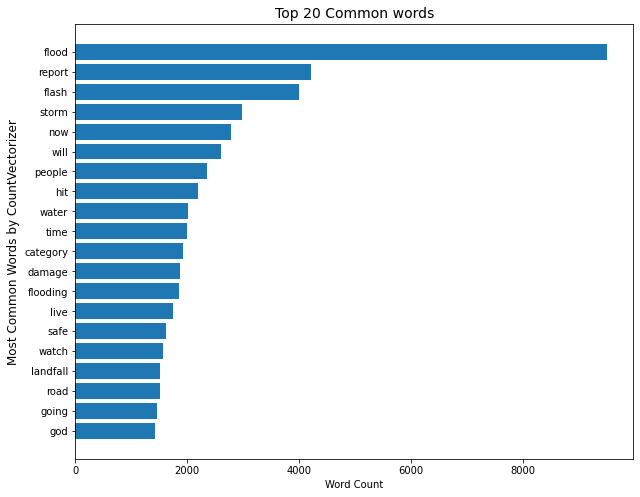

In [109]:
# plot top 20 words 

fig, ax = plt.subplots(figsize = (10, 8))

ax.barh(most_common[0][:20], most_common[1][:20], align = 'center')

ax.set_yticks(most_common.index[:20])
ax.set_yticklabels(most_common[0][:20])
ax.invert_yaxis()  # labels read top-to-bottom

ax.set_xlabel('Word Count')
ax.set_ylabel('Most Common Words by CountVectorizer', size = 12)
ax.set_title('Top 20 Common words', size = 14)

plt.savefig('../images/top20_cvec.png');

In [110]:
## find the top 20 words for disaster related tweets and non-disaster tweets

disaster = df[df['label'] == 1]['text_clean']
nondisaster = df[df['label'] == 0]['text_clean']

# instantiate another cvecs

cvec_disaster = CountVectorizer(stop_words = stop)
cvec_nondisaster = CountVectorizer(stop_words = stop)

# transform and fit

disaster = cvec_disaster.fit_transform(disaster)
nondisaster = cvec_nondisaster.fit_transform(nondisaster)

# store them in dataframes

disaster_df = pd.DataFrame(disaster.toarray(), 
                           columns = cvec_disaster.get_feature_names())

nondisaster_df = pd.DataFrame(nondisaster.toarray(),
                              columns = cvec_nondisaster.get_feature_names())

## get count of common words

# empty dictionaries

common_disaster = {}
common_nondisaster = {}

# loop through columns in sub1_df

for col in disaster_df.columns:
    
    # save sum of each column in dictionary
    common_disaster[col] = disaster_df[col].sum()  
    
# common to dataframe sorted by highest occurance

most_common_disaster = pd.DataFrame(sorted(common_disaster.items(), key = lambda x: x[1], reverse = True))

# loop through columns in sub2_df

for col in nondisaster_df.columns:
    
    # save sum of each column in dictionary
    common_nondisaster[col] = nondisaster_df[col].sum()  
    
# common to dataframe sorted by highest occurance

most_common_nondisaster = pd.DataFrame(sorted(common_nondisaster.items(), key = lambda x: x[1], reverse = True))

In [111]:
# top 20 words in disaster

most_common_disaster[:20].head(3)

,0,1
0,flood,9489
1,report,4124
2,flash,3975


In [112]:
# top 20 words in non-disaster

most_common_nondisaster[:20].head(3)

,0,1
0,hit,1531
1,now,1501
2,people,1422


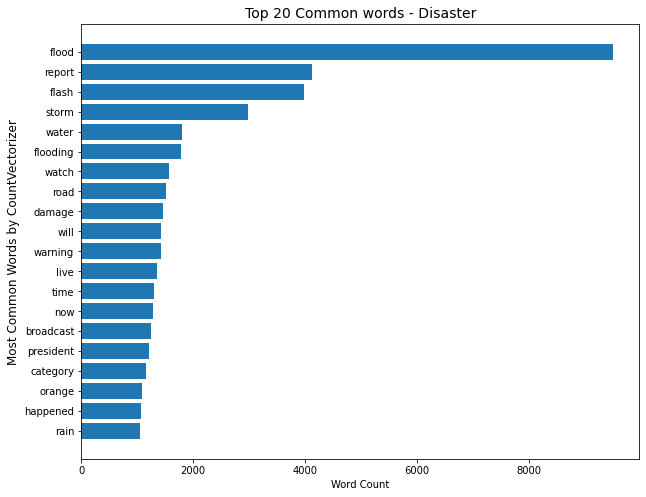

In [113]:
# plot top 20 words in disaster

fig, ax = plt.subplots(figsize = (10, 8))

ax.barh(most_common_disaster[0][:20], most_common_disaster[1][:20], align='center')

ax.set_yticks(most_common_disaster.index[:20])
ax.set_yticklabels(most_common_disaster[0][:20])
ax.invert_yaxis()  # labels read top-to-bottom

ax.set_xlabel('Word Count')
ax.set_ylabel('Most Common Words by CountVectorizer', size = 12)
ax.set_title('Top 20 Common words - Disaster', size = 14)

plt.savefig('../images/top20_disaster_cvec.png');

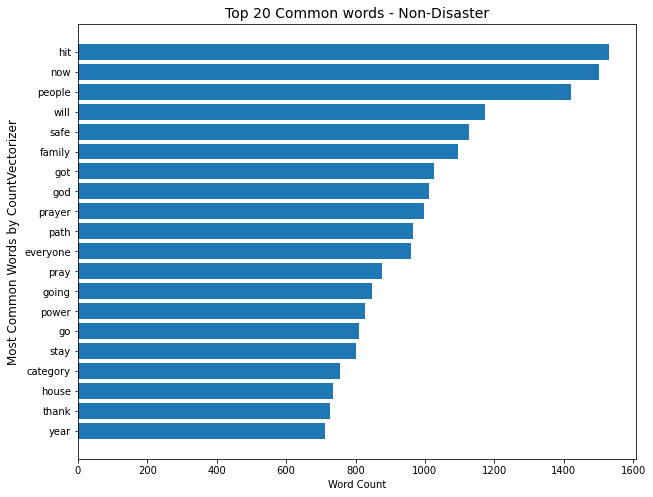

In [114]:
# plot top 20 words - non-disaster

fig, ax = plt.subplots(figsize = (10, 8))

ax.barh(most_common_nondisaster[0][:20], most_common_nondisaster[1][:20], align='center')

ax.set_yticks(most_common_nondisaster.index[:20])
ax.set_yticklabels(most_common_nondisaster[0][:20])
ax.invert_yaxis()  # labels read top-to-bottom

ax.set_xlabel('Word Count')
ax.set_ylabel('Most Common Words by CountVectorizer', size = 12)
ax.set_title('Top 20 Common words - Non-Disaster', size = 14)

plt.savefig('../images/top20_nondisaster_cvec.png');

In [ ]:
#TF-IDF vectorizer

In [115]:
# instantiate countvectorizer with stopwords

tvec = TfidfVectorizer(stop_words = stop)

In [116]:
# transform and fit on X_train, and transform X_test

X_tv = tvec.fit_transform(X)

print(X_tv.shape)

(41076, 28229)


In [117]:
# turn X_train to a dataframe

X_tv_df = pd.DataFrame(X_tv.toarray(), 
                       columns = tvec.get_feature_names())

In [118]:
# get count of common words

# empty dictionary

common = {}

# loop through columns

for col in X_tv_df.columns:
    
    # save sum of each column in dictionary
    common[col] = X_tv_df[col].sum()  
    
# common to dataframe sorted by highest occurance

most_common = pd.DataFrame(sorted(common.items(), key = lambda x: x[1], reverse = True))

In [119]:
# find top 20 words

most_common[:20].head(3)

,0,1
0,flood,1047.402372
1,flash,570.288239
2,report,547.355982


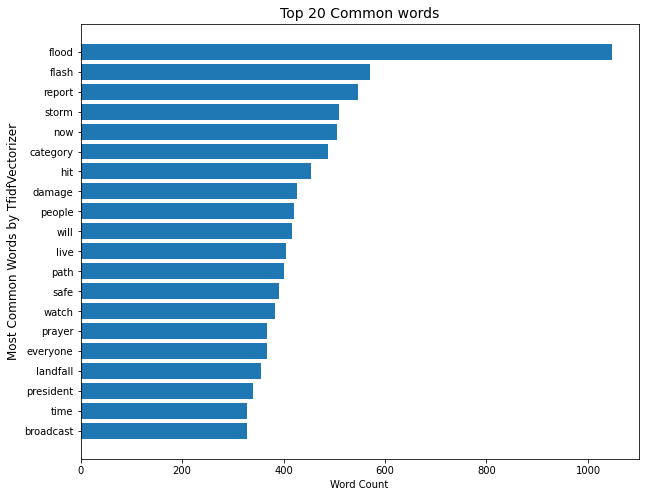

In [120]:
# plot top 20 words 

fig, ax = plt.subplots(figsize = (10, 8))

ax.barh(most_common[0][:20], most_common[1][:20], align='center')

ax.set_yticks(most_common.index[:20])
ax.set_yticklabels(most_common[0][:20])
ax.invert_yaxis()  # labels read top-to-bottom

ax.set_xlabel('Word Count')
ax.set_ylabel('Most Common Words by TfidfVectorizer', size = 12)
ax.set_title('Top 20 Common words', size = 14)

plt.savefig('../images/top20_tfidf.png');

In [121]:
## find the top 20 words for disaster related tweets and non-disaster tweets

disaster = df[df['label'] == 1]['text_clean']
nondisaster = df[df['label'] == 0]['text_clean']

# instantiate another cvecs

tvec_disaster = TfidfVectorizer(stop_words = stop)
tvec_nondisaster = TfidfVectorizer(stop_words = stop)

# transform and fit

disaster = tvec_disaster.fit_transform(disaster)
nondisaster = tvec_nondisaster.fit_transform(nondisaster)

# store them in dataframes

disaster_df = pd.DataFrame(disaster.toarray(), 
                           columns = tvec_disaster.get_feature_names())

nondisaster_df = pd.DataFrame(nondisaster.toarray(),
                              columns = tvec_nondisaster.get_feature_names())

## get count of common words

# empty dictionaries

common_disaster = {}
common_nondisaster = {}

# loop through columns in sub1_df

for col in disaster_df.columns:
    
    # save sum of each column in dictionary
    common_disaster[col] = disaster_df[col].sum()  
    
# common to dataframe sorted by highest occurance

most_common_disaster = pd.DataFrame(sorted(common_disaster.items(), key = lambda x: x[1], reverse = True))

# loop through columns in sub2_df

for col in nondisaster_df.columns:
    
    # save sum of each column in dictionary
    common_nondisaster[col] = nondisaster_df[col].sum()  
    
# common to dataframe sorted by highest occurance

most_common_nondisaster = pd.DataFrame(sorted(common_nondisaster.items(), key = lambda x: x[1], reverse = True))

In [122]:
# top 20 words in disaster

most_common_disaster[:20].head(3)

,0,1
0,flood,787.502363
1,flash,485.388637
2,report,461.181195


In [123]:
# top 20 words in non-disaster

most_common_nondisaster[:20].head(3)

,0,1
0,hit,330.592059
1,path,309.846616
2,now,297.567021


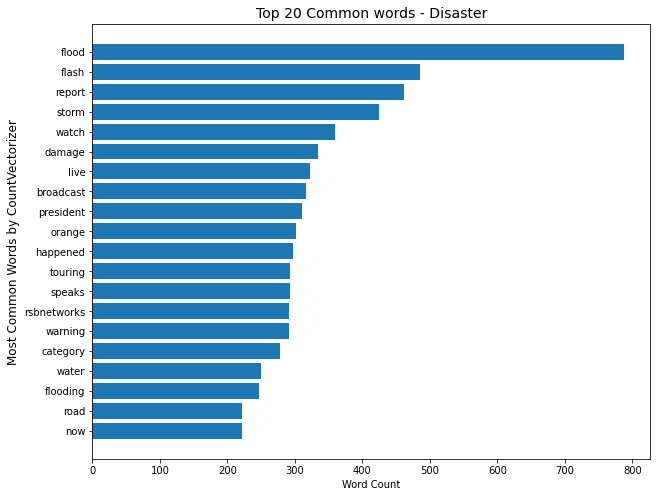

In [124]:
# plot top 20 words in disaster

fig, ax = plt.subplots(figsize = (10, 8))

ax.barh(most_common_disaster[0][:20], most_common_disaster[1][:20], align='center')

ax.set_yticks(most_common_disaster.index[:20])
ax.set_yticklabels(most_common_disaster[0][:20])
ax.invert_yaxis()  # labels read top-to-bottom

ax.set_xlabel('Word Count')
ax.set_ylabel('Most Common Words by CountVectorizer', size = 12)
ax.set_title('Top 20 Common words - Disaster', size = 14)

plt.savefig('../images/top20_disaster_t.png');

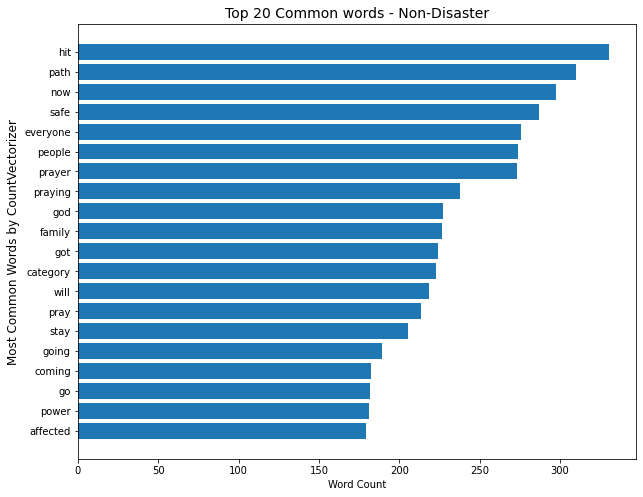

In [125]:
# plot top 20 words - non-disaster

fig, ax = plt.subplots(figsize = (10, 8))

ax.barh(most_common_nondisaster[0][:20], most_common_nondisaster[1][:20], align='center')

ax.set_yticks(most_common_nondisaster.index[:20])
ax.set_yticklabels(most_common_nondisaster[0][:20])
ax.invert_yaxis()  # labels read top-to-bottom

ax.set_xlabel('Word Count')
ax.set_ylabel('Most Common Words by CountVectorizer', size = 12)
ax.set_title('Top 20 Common words - Non-Disaster', size = 14)

plt.savefig('../images/top20_nondisaster_t.png');

In [ ]:
# Word Cloud

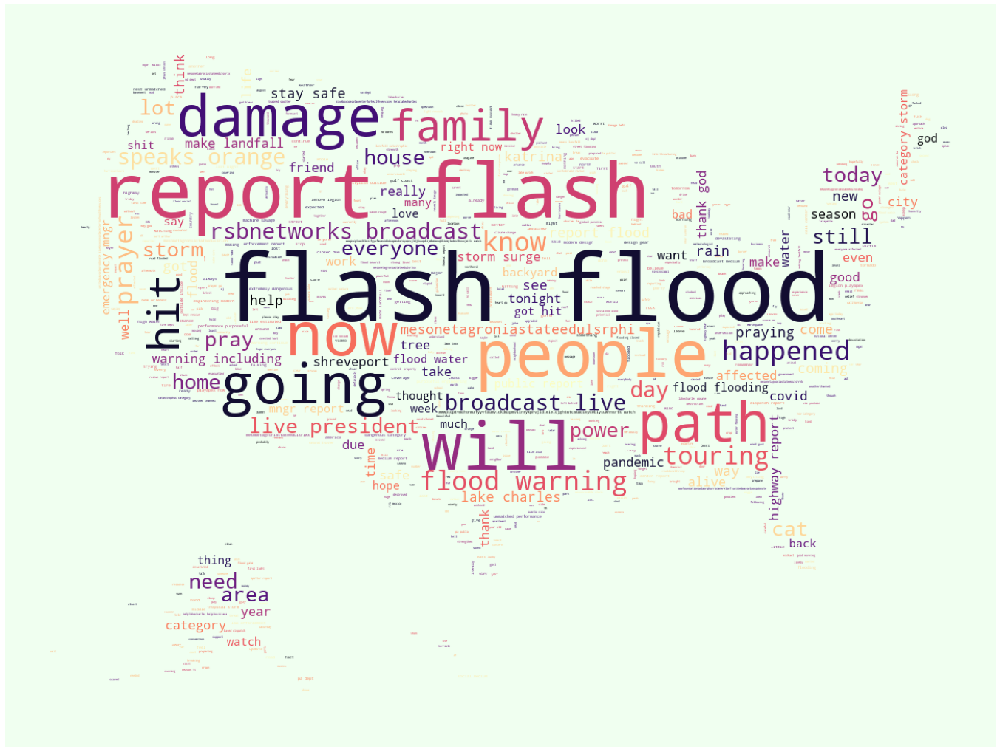

In [137]:
# Wordcloud with stopwords

mask = np.array(Image.open('../images/usa.jpg'))
txt = ' '.join(df['text_clean'].dropna())

wc = WordCloud(mask = mask, max_words = 4000, stopwords = stop, colormap = 'magma', 
               background_color = 'honeydew', random_state = 42).generate(txt)
plt.figure(figsize = (24, 24))

plt.imshow(wc)
plt.axis('off')
plt.title('')
plt.savefig('../images/wc_stopwords.png');

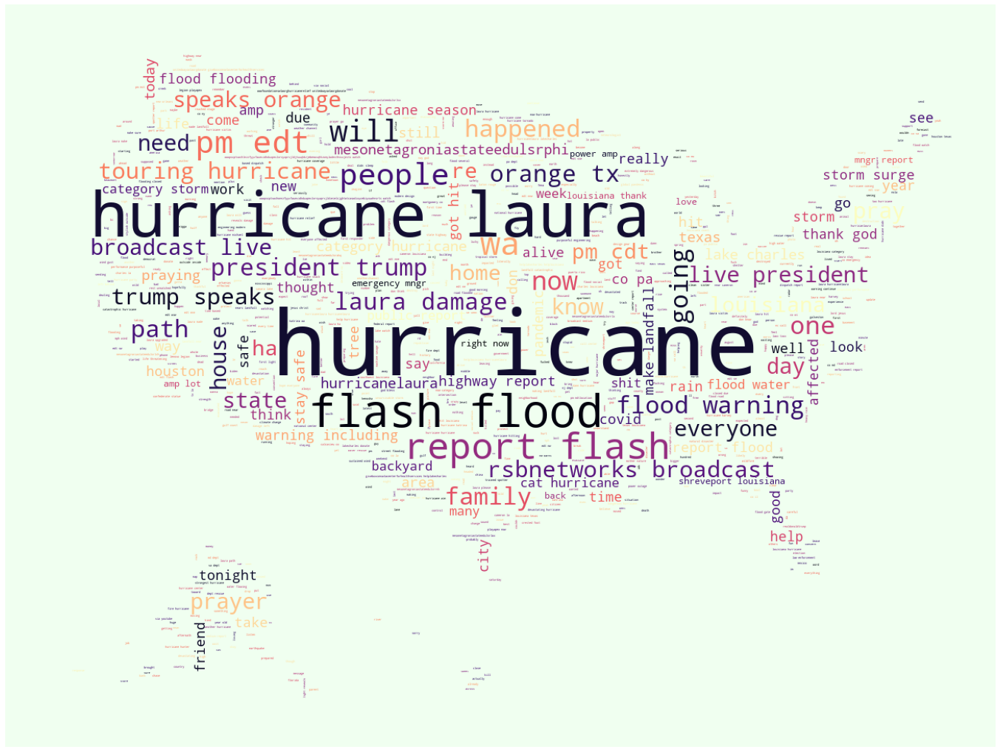

In [138]:
# Wordcloud without stopwords

mask = np.array(Image.open('../images/usa.jpg'))
txt = ' '.join(df['text_clean'].dropna())

wc = WordCloud(mask = mask, max_words = 4000, stopwords = None, colormap = 'magma', 
               background_color = 'honeydew', random_state = 42).generate(txt)
plt.figure(figsize = (24, 24))

plt.imshow(wc)
plt.axis('off')
plt.title('')
plt.savefig('../images/wc_nostop.png');